# Nighttime Lights Trends in Egypt

The purpose of this notebook is to conduct an examination of the spatial and temporal distribution of lights during the night in Egypt. The dataset utilized is derived from [NASA's Black Marble](https://blackmarble.gsfc.nasa.gov).

In [25]:
import os
from datetime import datetime

import colorcet as cc
import contextily as cx
import dask.dataframe as dd
import geopandas
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import xarray as xr
from blackmarble.extract import bm_extract
from blackmarble.raster import bm_raster, transform
from bokeh.models import ColumnDataSource, HoverTool, Legend, Range1d, Span, Text, Title
from bokeh.plotting import figure, output_notebook, show
from rasterstats import zonal_stats

%load_ext autoreload
%autoreload 2

%matplotlib inline
import matplotlib_inline
matplotlib_inline.backend_inline.set_matplotlib_formats('svg')

pd.set_option("display.max_rows", None)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
# https://papermill.readthedocs.io/en/latest/usage-parameterize.html
COUNTRY = "Egypt"
VAR = "ntl_sum"
THRESHOLDS = [1, 10, 100]

bearer = os.getenv("BLACKMARBLE_TOKEN")

## Data

### Region of Interest

Define region of interest for which we want to download nighttime lights data. We use [geoBoundaries](https://www.geoboundaries.org) {cite:p}`10.1371/journal.pone.0231866`. Country borders or names do not necessarily reflect the World Bank Group’s official position. This map is for illustrative purposes and does not imply the expression of any opinion on the part of the World Bank, concerning the legal status of any country or territory or concerning the delimitation of frontiers or boundaries.

In [3]:
EGY = geopandas.read_file(
    "https://github.com/wmgeolab/geoBoundaries/raw/main/releaseData/gbOpen/EGY/ADM1/geoBoundaries-EGY-ADM1.geojson"
)
EGY["shapeName"] = EGY["shapeName"].str.replace("Governorate", "")
EGY.explore()

```{figure} ../../docs/images/logo.png
---
height: 0px
---
Country borders or names do not necessarily reflect the World Bank Group’s official position. This map is for illustrative purposes and does not imply the expression of any opinion on the part of the World Bank, concerning the legal status of any country or territory or concerning the delimitation of frontiers or boundaries.
```

### NASA Black Marble 

[NASA's Black Marble](https://blackmarble.gsfc.nasa.gov) Nighttime Lights dataset represents a remarkable advancement in our ability to monitor and understand nocturnal light emissions on a global scale. By utilizing cutting-edge satellite technology and image processing techniques, the Black Marble VIIRS dataset offers a comprehensive and high-resolution view of the Earth's nighttime illumination patterns.

In [ ]:
EGY_VNP46A4r = bm_raster(
    EGY,
    product_id="VNP46A4",
    date_range=pd.date_range("2012-01-01", "2022-01-01", freq="YS"),
    bearer=bearer,
)

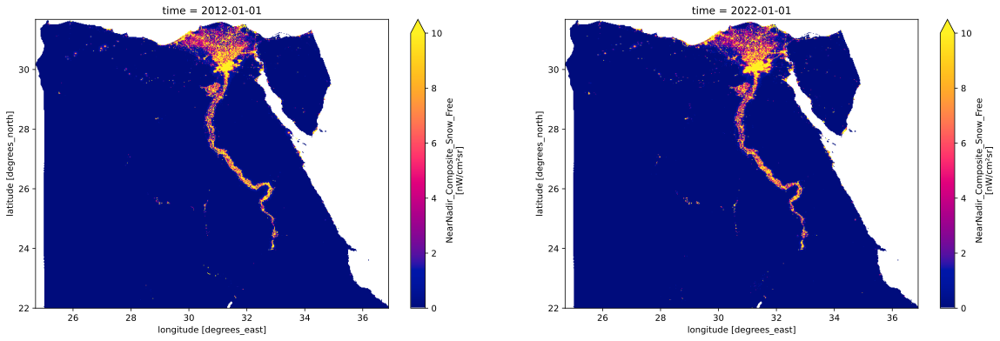

In [26]:
fig, axs = plt.subplots(1, 2, figsize=(20, 6))

# Select first and last periods
periods = [EGY_VNP46A4r["time"][0], EGY_VNP46A4r["time"][-1]]

for i, t in enumerate(periods):
    ax = axs[i]

    EGY_VNP46A4r["NearNadir_Composite_Snow_Free"].sel(time=t).plot.imshow(
        ax=ax,
        cmap=cc.cm.bmy,
        robust=True,
        vmax=10,
    )

```{figure} ../../docs/images/logo.png
---
height: 0px
---
Nasa Black Marble 2012 and 2022 (latest available) yearly composites (VNP46A4).
```

In the step next, we download the daily, monthly and yearly nighlights data from [NASA Black Marble](https://blackmarble.gsfc.nasa.gov) for Egypt.

In [ ]:
EGY_VNP46A4 = bm_extract(
    EGY,
    product_id="VNP46A4",
    date_range=pd.date_range("2012-01-01", "2022-01-01", freq="YS"),
    bearer=bearer,
    aggfunc=["mean", "sum"],
)
EGY_VNP46A3 = bm_extract(
    EGY,
    product_id="VNP46A3",
    date_range=pd.date_range("2012-01-01", "2023-10-01", freq="MS"),
    bearer=bearer,
    aggfunc=["mean", "sum"],
)
EGY_VNP46A2 = bm_extract(
    EGY,
    product_id="VNP46A2",
    date_range=pd.date_range("2023-01-01", "2023-12-31", freq="D"),
    bearer=bearer,
    aggfunc=["mean", "sum"],
)

In [7]:
EGY_VNP46A2["date"].max().strftime("%d %B %Y (Week %W)")

'11 December 2023 (Week 50)'

## Methodology

Creating a time series of nightly radiance using NASA's Black Marble data involves several steps, including data acquisition, pre-processing, zonal statistics calculation, and time series generation. Below is a general methodology for this process.

#### Monthly

In this step, we compute a monthy aggregation of the zonal statistics by for each second-level administrative division and for each month. We use both the average lights and sum of lights (SOL) {cite:p}`RePEc:gam:jsusta:v:5:y:2013:i:12:p:4988-5019:d:30764`). Additionaly, we add the [VNP46A3](https://ladsweb.modaps.eosdis.nasa.gov/missions-and-measurements/products/VNP46A3/#data-availability) monthly composite and [VNP46A4](https://ladsweb.modaps.eosdis.nasa.gov/missions-and-measurements/products/VNP46A4/#data-availability) yearly composite, when available.

###  Time Series Generation

Organize the zonal statistics results in a tabular format, where each columnn corresponds to a specific zone, and rows represent the radiance values. Next, we aggregate the data temporally, computing the desired statistical metric for each zone for each time slot. Finally, we will visualize the time series data to observe trends, patterns, and anomalies over time.

In [8]:
EGY_TABLE = EGY_VNP46A3.pivot_table(
    index="date",
    columns=["shapeName"],
    values=[VAR],
)

In [9]:
p = figure(
    title=f"{COUNTRY}: Monthly Nightlights (2012-2023)",
    width=800,
    height=800,
    x_axis_label="Date",
    x_axis_type="datetime",
    y_axis_label=r"Sum of Lights [nW $$cm^{-2}$$ $$sr^{-1}$$]",
    y_axis_type="log",
    tools="pan,wheel_zoom,box_zoom,reset,save,box_select",
)
p.add_layout(
    Title(
        text=f"Monthly Sum of Lights (VNP46A3)",
        text_font_size="12pt",
        text_font_style="italic",
    ),
    "above",
)
p.add_layout(
    Title(
        text=f"Data Source: NASA Black Marble. Creation date: {datetime.today().strftime('%d %B %Y')}. Feedback: datalab@worldbank.org.",
        text_font_size="10pt",
        text_font_style="italic",
    ),
    "below",
)
p.add_layout(Legend(), "right")

p.add_tools(
    HoverTool(
        tooltips=[
            ("Month", "@x{%B %Y}"),
            ("Sum of Lights (SOL)", "@y{0.00}"),
        ],
        formatters={"@x": "datetime"},
    )
)

# Renderers
for column, color in zip(EGY_TABLE.columns, cc.b_glasbey_category10):
    r = p.line(
        EGY_TABLE.index,
        EGY_TABLE[column],
        legend_label=column[1],
        line_color=color,
        line_width=2,
    )
    r.visible = False

    if str(column[1]) == "Cairo":
        r.visible = True

p.legend.location = "bottom_left"
p.legend.click_policy = "hide"
p.title.text_font_size = "16pt"
p.sizing_mode = "scale_both"

output_notebook()
show(p)

Loading BokehJS ...

## Findings

### Nightlights Concentration

The average nighttime lights radiance for urban areas can vary significantly based on multiple factors such as city size, population density, infrastructure, economic activity and geographical location. In general, larger and more densely populated urban areas tend to have higher nighttime lights radiance due to increased artificial lighting from street lights, buildings, and other sources. "Nightlights Concentration" refers to the density and distribution of artificial lighting visible during nighttime within urban and rural areas. It may serve as a key indicator of urban development, economic activity, and population density. 

In [10]:
EGY_VNP46A3_2012 = bm_raster(
    EGY,
    product_id="VNP46A3",
    date_range="2012-10-01",
    bearer=bearer,
).sel(time="2012-10-01")

EGY_VNP46A3_2023 = bm_raster(
    EGY,
    product_id="VNP46A3",
    date_range="2023-10-01",
    bearer=bearer,
).sel(time="2023-10-01")

GETTING MANIFEST...:   0%|          | 0/4 [00:00<?, ?it/s]

QUEUEING TASKS | Downloading...:   0%|          | 0/4 [00:00<?, ?it/s]

PROCESSING TASKS | Downloading...:   0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0.00/10.1M [00:00<?, ?B/s]

  0%|          | 0.00/13.8M [00:00<?, ?B/s]

  0%|          | 0.00/19.4M [00:00<?, ?B/s]

  0%|          | 0.00/11.3M [00:00<?, ?B/s]

COLLECTING RESULTS | Downloading...:   0%|          | 0/4 [00:00<?, ?it/s]

COLLATING RESULTS | Processing...:   0%|          | 0/1 [00:00<?, ?it/s]

GETTING MANIFEST...:   0%|          | 0/4 [00:00<?, ?it/s]

QUEUEING TASKS | Downloading...:   0%|          | 0/4 [00:00<?, ?it/s]

PROCESSING TASKS | Downloading...:   0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0.00/13.0M [00:00<?, ?B/s]

  0%|          | 0.00/21.5M [00:00<?, ?B/s]

  0%|          | 0.00/16.1M [00:00<?, ?B/s]

  0%|          | 0.00/12.1M [00:00<?, ?B/s]

COLLECTING RESULTS | Downloading...:   0%|          | 0/4 [00:00<?, ?it/s]

COLLATING RESULTS | Processing...:   0%|          | 0/1 [00:00<?, ?it/s]

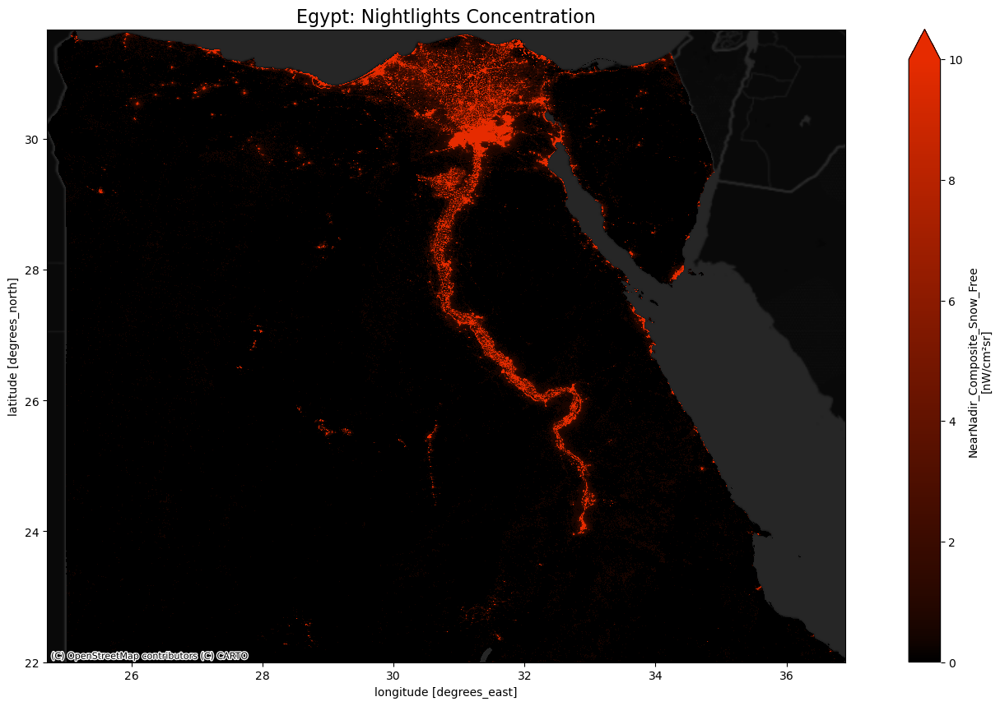

In [11]:
fig, ax = plt.subplots(figsize=(20, 10))

EGY_VNP46A3_2023["NearNadir_Composite_Snow_Free"].plot.pcolormesh(
    ax=ax, cmap=cc.cm.kr, vmax=10, robust=True
)
cx.add_basemap(
    ax=ax, crs=EGY.crs.to_string(), source=cx.providers.CartoDB.DarkMatterNoLabels
)
ax.set_title(f"{COUNTRY}: Nightlights Concentration", fontsize=16);

```{figure} ../../docs/images/logo.png
---
height: 0px
---
Nightlights concentration in Egypt as of October 2023 (NASA Black Marble VNP46A3).
```

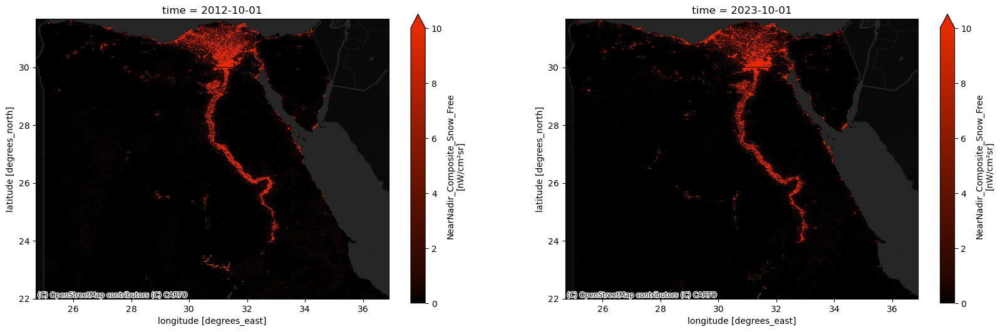

In [12]:
fig, axs = plt.subplots(1, 2, figsize=(20, 6))

EGY_VNP46A3_2012["NearNadir_Composite_Snow_Free"].plot.pcolormesh(
    ax=axs[0],
    cmap=cc.cm.kr,
    robust=True,
    vmax=10,
)
cx.add_basemap(
    axs[0], crs=EGY.crs.to_string(), source=cx.providers.CartoDB.DarkMatterNoLabels
)

EGY_VNP46A3_2023["NearNadir_Composite_Snow_Free"].plot.pcolormesh(
    ax=axs[1],
    cmap=cc.cm.kr,
    robust=True,
    vmax=10,
)
cx.add_basemap(
    axs[1], crs=EGY.crs.to_string(), source=cx.providers.CartoDB.DarkMatterNoLabels
)

Areas with higher nightlights concentration often denote bustling urban centers or regions with significant industrial and commercial activity. We select nightlights above thresholds. 

In [27]:
fig, ax = plt.subplots(figsize=(20, 10))

EGY_VNP46A3_2023["NearNadir_Composite_Snow_Free"].plot.contour(
    ax=ax, cmap=cc.cm.bmy, add_colorbar=True, levels=[10, 25, 50, 100]
)

# Add boundaries
ax = EGY.boundary.plot(ax=ax, color="gray", linewidth=0.5)
cx.add_basemap(
    ax, crs=EGY.crs.to_string(), source=cx.providers.CartoDB.DarkMatterNoLabels
)

ax.set_title(f"{COUNTRY}: Areas with higher nightlights radiance", fontsize=16);

```{figure} ../../docs/images/logo.png
---
height: 0px
---
Areas with higher nightlights radiance above the respective threshold.
```

Now, we estimate the area percentage above the threshold (1, 10, 100) for each administrative division. 

In [14]:
results = []
for threshold in THRESHOLDS:
    da = xr.where(EGY_VNP46A3_2023["NearNadir_Composite_Snow_Free"] >= threshold, 1, 0)
    zs = zonal_stats(
        EGY,
        da.values,
        affine=transform(da),
        stats=["mean"],
    )
    zs = pd.concat([EGY, pd.DataFrame(zs)], axis=1)

    zs["Threshold"] = threshold
    zs["Area (%)"] = 100 * zs["mean"]

    results.append(zs)

CONCENTRATION = pd.concat(results)

CONCENTRATION[["shapeISO", "shapeName", "Threshold", "Area (%)"]].set_index(
    ["shapeISO", "shapeName", "Threshold"]
).sort_index()

Area (%)
shapeISO shapeName       Threshold           
EG-ALX   Alexandria      1          61.955594
                         10         18.865642
                         100         1.316539
EG-ASN   Aswan           1           3.830535
                         10          0.708651
                         100         0.045506
EG-AST   Asyut           1          12.830261
                         10          2.599845
                         100         0.050416
EG-BA    Red Sea         1           0.964987
                         10          0.278842
                         100         0.019664
EG-BH    Beheira         1          58.290564
                         10          4.781792
                         100         0.147597
EG-BNS   Beni Suef       1          18.737753
                         10          2.779056
                         100         0.015335
EG-C     Cairo           1          80.105003
                         10         46.374305
                         100         4.873379
EG-DK    Dakahlia        1          83.545064
                         10         12.210300
                         100         2.532189
EG-DT    Damietta        1          85.626911
                         10         21.442706
                         100         6.314085
EG-FYM   Faiyum          1          35.262882
                         10          5.205192
                         100         0.114724
EG-GH    Gharbiyya       1          98.682503
                         10         14.372692
                         100         0.029943
EG-GZ    Giza            1           9.523296
                         10          3.067822
                         100         0.144709
EG-IS    Ismailia        1          40.012766
                         10          4.991489
                         100         0.119149
EG-JS    South Sinai     1           2.905969
                         10          0.858625
                         100         0.073211
EG-KB    Qalyubia        1          99.937304
                         10         50.642633
                         100         0.736677
EG-KFS   Kafr el-Sheikh  1          71.314932
                         10          4.759835
                         100         0.030428
EG-KN    Qena            1          12.240188
                         10          2.569660
                         100         0.007796
EG-LX    Luxor Governate 1          61.800958
                         10         18.060507
                         100         0.050932
EG-MN    Minya Governate 1          11.349890
                         10          1.634934
                         100         0.016207
EG-MNF   Monufia         1          95.776664
                         10         15.613815
                         100         0.107373
EG-MT    Matrouh         1           2.423757
                         10          0.478989
                         100         0.033034
EG-PTS   Port Said       1          35.094142
                         10          7.819038
                         100         3.451883
EG-SHG   Sohag           1          16.531440
                         10          4.676583
                         100         0.060101
EG-SHR   Al Sharqia      1          90.163620
                         10         15.440160
                         100         0.318789
EG-SIN   North Sinai     1           3.129115
                         10          0.415121
                         100         0.002674
EG-SUZ   Suez            1          16.718151
                         10          3.540096
                         100         0.115326
EG-WAD   New Valley      1           0.689880
                         10          0.114560
                         100         0.004331

Next, we visualize the percentage of areas with higher nightlights radiance with threshold 10 for each second-level administrative division. This threshold should indicate urban centers or areas with significant commercial or industrial activities. Please note that 

In [15]:
EGY2 = geopandas.read_file(
    "https://github.com/wmgeolab/geoBoundaries/raw/main/releaseData/gbOpen/EGY/ADM2/geoBoundaries-EGY-ADM2.geojson"
)

results = []
for threshold in THRESHOLDS:
    da = xr.where(EGY_VNP46A3_2023["NearNadir_Composite_Snow_Free"] >= threshold, 1, 0)
    zs = zonal_stats(
        EGY2,
        da.values,
        affine=transform(da),
        stats=["mean"],
    )
    zs = pd.concat([EGY2, pd.DataFrame(zs)], axis=1)

    zs["Threshold"] = threshold
    zs["Area (%)"] = 100 * zs["mean"]

    results.append(zs)

CONCENTRATION = pd.concat(results)

In [16]:
CONCENTRATION[CONCENTRATION["Threshold"] == 10].explore(column="Area (%)", cmap="OrRd")

```{figure} ../../docs/images/logo.png
---
height: 0px
---
Nightlights concentration in area percentage using threshold 10 in Egypt. 
```

Finally, we estimate the percentage of areas with higher nightlights radiance (with thresholds 1, 10, 100) nationally.

In [17]:
EGY0 = geopandas.read_file(
    "https://github.com/wmgeolab/geoBoundaries/raw/main/releaseData/gbOpen/EGY/ADM0/geoBoundaries-EGY-ADM0.geojson"
)

results = []
for threshold in THRESHOLDS:
    da = xr.where(EGY_VNP46A3_2023["NearNadir_Composite_Snow_Free"] >= threshold, 1, 0)
    zs = zonal_stats(
        EGY0,
        da.values,
        affine=transform(da),
        stats=["mean"],
    )
    zs = pd.concat([EGY0, pd.DataFrame(zs)], axis=1)

    zs["Threshold"] = threshold
    zs["Area (%)"] = 100 * zs["mean"]

    results.append(zs)

pd.concat(results)[["shapeName", "Threshold", "Area (%)"]]

,shapeName,Threshold,Area (%)
0,Egypt,1,6.128890
0,Egypt,10,1.227392
0,Egypt,100,0.070555


### Nightlights Trends

#### Year-over-Year Comparison 

In this step, we calculate the difference between the 2012 and 2022 (latest available) [VNP46A4](https://ladsweb.modaps.eosdis.nasa.gov/missions-and-measurements/products/VNP46A4/#data-availability) yearly composites.

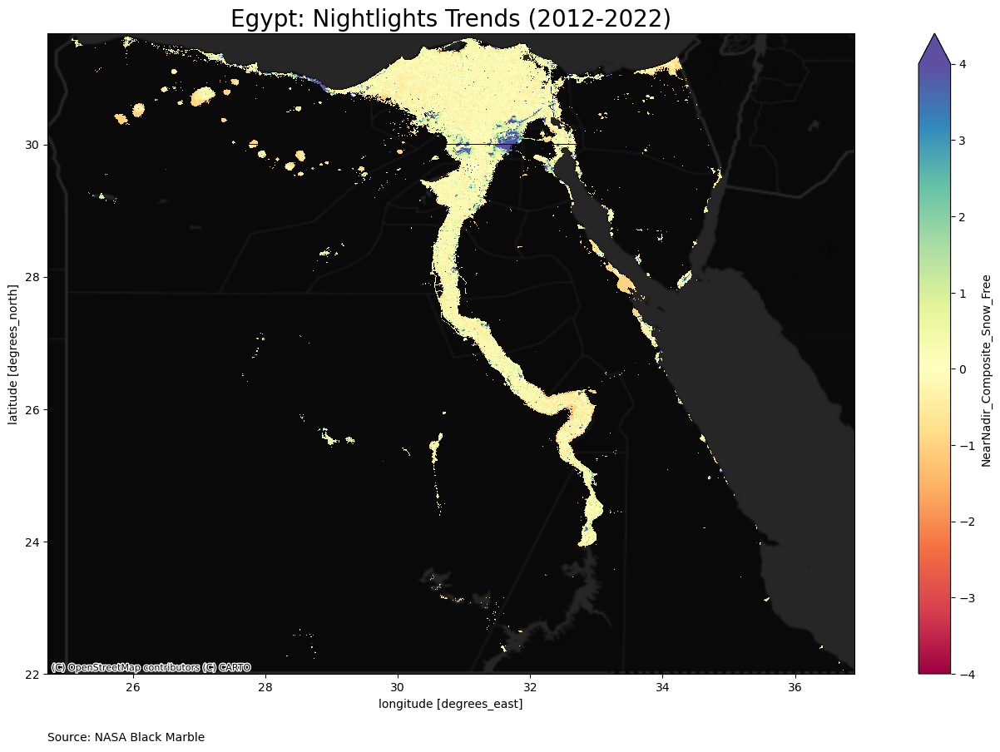

In [18]:
fig, ax = plt.subplots(figsize=(20, 10))

delta = (
    (
        EGY_VNP46A4r["NearNadir_Composite_Snow_Free"].sel(time="2022-01-01")
        - EGY_VNP46A4r["NearNadir_Composite_Snow_Free"].sel(time="2012-01-01")
    )
    / EGY_VNP46A4r["NearNadir_Composite_Snow_Free"].sel(time="2012-01-01")
).plot.pcolormesh(ax=ax, cmap="Spectral", robust=True, vmin=-4, vmax=4)
cx.add_basemap(
    ax, crs=EGY.crs.to_string(), source=cx.providers.CartoDB.DarkMatterNoLabels
)

ax.text(
    0,
    -0.1,
    "Source: NASA Black Marble",
    ha="left",
    va="center",
    transform=ax.transAxes,
    fontsize=10,
    color="black",
    weight="normal",
)
ax.set_title(f"{COUNTRY}: Nightlights Trends (2012-2022)", fontsize=20);

```{figure} ../../docs/images/logo.png
---
height: 0px
---
Difference  between 2012 and 2022 in sum of lights (SOL) based on NASA Black Marble's VNP46A4 yearly composites. Country borders or names do not necessarily reflect the World Bank Group’s official position. This map is for illustrative purposes and does not imply the expression of any opinion on the part of the World Bank, concerning the legal status of any country or territory or concerning the delimitation of frontiers or boundaries.
```

#### Benchmark Comparison

In this exploratory analysis, we conducted analysis of NTL radiance trends, comparing the observed average radiance levels in 2012-2022 for each second-level administrative division.

In [19]:
EGY_benchmark = 100 * (EGY_TABLE / EGY_TABLE[(EGY_TABLE.index.year <= 2022)].mean() - 1)
EGY_benchmark = EGY_benchmark[EGY_benchmark < 250]

pd.set_option("display.max_rows", None)
EGY_benchmark.style.map(
    lambda x: "background-color: #DF4661" if x < -100 else "background-color: white"
)

In [ ]:
EGY_benchmark.to_csv(f"../../data/ntl/{COUNTRY}_1-VNP46A3-MS-percentchange.csv")

```{figure} ../../docs/images/logo.png
---
height: 0px
---
Monthly percent change compared to the baseline. Values in red indicate a negative percent change.
```

In [20]:
p = figure(
    title=f"{COUNTRY}: Percent Change in Nightlights",
    width=800,
    height=800,
    x_axis_label="Date",
    x_axis_type="datetime",
    y_axis_label="Percent Change [%]",
    tools="pan,wheel_zoom,box_zoom,reset,save,box_select",
)
p.add_layout(
    Title(
        text=f"Monthly percent change in sum of lights (compared to 2012-2022 baseline) for each first-level administrative division",
        text_font_size="12pt",
        text_font_style="italic",
    ),
    "above",
)
p.add_layout(
    Title(
        text=f"Source: NASA Black Marble. Creation date: {datetime.today().strftime('%d %B %Y')}. Feedback: datalab@worldbank.org.",
        text_font_size="10pt",
        text_font_style="italic",
    ),
    "below",
)
p.add_layout(Legend(), "right")
p.add_tools(
    HoverTool(
        tooltips=[
            ("Month", "@x{%B %Y}"),
            ("Percent Change", "@y{0.00}% (2012-2022 baseline)"),
        ],
        formatters={"@x": "datetime"},
    )
)

# Renderers
hline = Span(
    location=0, dimension="width", line_color="green", line_width=3, line_dash="dotted"
)
p.renderers.extend([hline])

for column, color in zip(EGY_benchmark.columns, cc.b_glasbey_category10):
    r = p.line(
        EGY_benchmark.index,
        EGY_benchmark[column],
        legend_label=str(column[1]),
        line_color=color,
        line_width=2,
    )
    r.visible = False

    if str(column[1]) == "Cairo":
        r.visible = True

p.legend.location = "bottom_left"
p.legend.click_policy = "hide"
p.title.text_font_size = "12pt"
p.sizing_mode = "scale_both"
show(p)

```{figure} ../../docs/images/logo.png
---
height: 0px
---
Monthly percent change in sum of lights (compared to 2012-2022 baseline) for each first-level administrative division.
```

#### Regional Comparison 

In this step, we include other countries from the region for comparison.

In [21]:
TUR = geopandas.read_file(
    "https://github.com/wmgeolab/geoBoundaries/raw/main/releaseData/gbOpen/TUR/ADM1/geoBoundaries-TUR-ADM1.geojson"
)
TUR.explore(color="red")

```{figure} ../../docs/images/logo.png
---
height: 0px
---
Country borders or names do not necessarily reflect the World Bank Group’s official position. This map is for illustrative purposes and does not imply the expression of any opinion on the part of the World Bank, concerning the legal status of any country or territory or concerning the delimitation of frontiers or boundaries.
```

Now, in this step, we repeat the step of downloading from [NASA Black Marble](https://blackmarble.gsfc.nasa.gov/). 

In [ ]:
TUR_VNP46A3 = bm_extract(
    TUR,
    product_id="VNP46A3",
    date_range=pd.date_range("2012-01-01", "2023-10-01", freq="MS"),
    bearer=bearer,
    aggfunc=["mean", "sum"],
)
TUR_VNP46A4 = bm_extract(
    TUR,
    product_id="VNP46A4",
    date_range=pd.date_range("2012-01-01", "2022-01-01", freq="YS"),
    bearer=bearer,
    aggfunc=["mean", "sum"],
)

In [22]:
TUR_VNP46A3 = geopandas.read_file("../../data/ntl/TUR_VNP46A3.geojson")
TUR_VNP46A4 = geopandas.read_file("../../data/ntl/TUR_VNP46A4.geojson")

Finally, we compare Egypt and Türkiye in regard to sum of lights (SOL). 

In [23]:
REGIONAL = pd.concat(
    [
        EGY_VNP46A3.pivot_table(
            index="date",
            columns=["shapeName"],
            values=[VAR],
        )
        .sum(axis="columns")
        .to_frame("EGY"),
        TUR_VNP46A3.pivot_table(
            index="date",
            columns=["shapeName"],
            values=[VAR],
        )
        .sum(axis="columns")
        .to_frame("TUR"),
    ],
    axis="columns",
)
REGIONAL = REGIONAL[REGIONAL.index >= "2012-02-01"]

In [24]:
p = figure(
    title=f"Egypt and Türkiye: Monthly Nightlights (2012-2023)",
    width=800,
    height=800,
    x_axis_label="Date",
    x_axis_type="datetime",
    y_axis_label="Sum of Lights (SOL)",
    tools="pan,wheel_zoom,box_zoom,reset,save,box_select",
)
p.add_layout(
    Title(
        text=f"Monthly national sum of lights",
        text_font_size="12pt",
        text_font_style="italic",
    ),
    "above",
)
p.add_layout(
    Title(
        text=f"Source: NASA Black Marble. Creation date: {datetime.today().strftime('%d %B %Y')}. Feedback: datalab@worldbank.org.",
        text_font_size="10pt",
        text_font_style="italic",
    ),
    "below",
)
p.add_layout(Legend(), "right")
p.add_tools(
    HoverTool(
        tooltips=[
            ("Month", "@x{%B %Y}"),
            ("Sum of Lights", "@y{0.00}"),
        ],
        formatters={"@x": "datetime"},
    )
)

for column, color in zip(REGIONAL.columns, cc.b_glasbey_category10):
    r = p.line(
        REGIONAL.index,
        REGIONAL[column],
        legend_label=column,
        line_color=color,
        line_width=2,
    )

p.legend.location = "bottom_left"
p.legend.click_policy = "hide"
p.title.text_font_size = "12pt"
p.sizing_mode = "scale_both"
show(p)

## Limitations

```{seealso}
{ref}`nighttime-lights-limitations`
```

## References 

```{bibliography}
:filter: docname in docnames
:style: unsrt
```